# Generating Various Types of Graphs by Proximity
This notebook illustrates how to generate and visualize different spatial graph types based on proximity metrics (KNN, Delaunay, Gilbert, Waxman) using City2Graph, OSMnx, and NetworkX.

## Overview
This notebook covers:
- Setting up the environment and importing libraries
- Retrieving points of interest around a location
- Defining helper functions for node extraction and plotting
- Generating and visualizing KNN, Delaunay, Gilbert, and Waxman graphs interactively

## 1. Setup and Environment

In [1]:
import warnings

import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import networkx as nx
import osmnx as ox
from IPython.display import HTML
from matplotlib import animation

import city2graph as c2g

warnings.filterwarnings("ignore")

## 2. Retrieve Points of Interest
Fetch restaurant POIs around Shibuya, Tokyo using OSMnx and filter to nodes only. Also, streets network is obtained for calculating network distances.

In [2]:
poi_tags = {
    "amenity": ["restaurant"]
    }

#poi_gdf = ox.features_from_place("Shibuya, Tokyo, Japan", poi_tags)
poi_gdf = ox.features_from_point(
    (35.658514, 139.70133),  # Tokyo Tower coordinates
    tags=poi_tags,
    dist=1000,  # Search radius in meters
    )

# Filter to include only nodes, not ways and relations
poi_gdf = poi_gdf[poi_gdf.index.get_level_values("element") == "node"]

# Reproject to a projected CRS for accurate centroids
poi_gdf = poi_gdf.to_crs(epsg=6677)

In [3]:
segments_G = ox.graph_from_point(
    (35.658514, 139.70133),  # Tokyo Tower coordinates
    dist=1000,  # Search radius in meters
    )

segments_gdf = c2g.nx_to_gdf(segments_G, nodes=False, edges=True)

In [4]:
import matplotlib.colors as mcolors

def get_degree_colors(graph, cmap_name='plasma'):
    """Generate colors based on node degree."""
    if not graph:
        return []
    
    degree_dict = dict(graph.degree())
    values = list(degree_dict.values())
    
    if not values:
        return []
        
    norm = mcolors.Normalize(vmin=min(values), vmax=max(values))
    cmap = plt.get_cmap(cmap_name)
    
    # Match order of nodes in graph
    return [mcolors.to_hex(cmap(norm(degree_dict[n]))) for n in graph.nodes()]

## 3. K-Nearest Neighbors (KNN) Graph
Create an interactive slider to plot KNN graphs for varying $k$ values. You can specify the distance metric from `"manhattan"`, `"euclidean"`,  and `"network"`. If you use network distance, you need to set the GeoDataFrame of network. You can save the output as GeoDataFrame or nx.Graph.

In [5]:
knn_l1_nodes, knn_l1_edges = c2g.knn_graph(
    poi_gdf,
    distance_metric="manhattan",
    network_gdf=segments_gdf.to_crs(epsg=6677)
    )

knn_l2_nodes, knn_l2_edges = c2g.knn_graph(
    poi_gdf,
    distance_metric="euclidean",
    network_gdf=segments_gdf.to_crs(epsg=6677)
    )

knn_net_nodes, knn_net_edges = c2g.knn_graph(
    poi_gdf,
    k=10,
    distance_metric="network",
    network_gdf=segments_gdf.to_crs(epsg=6677)
    )

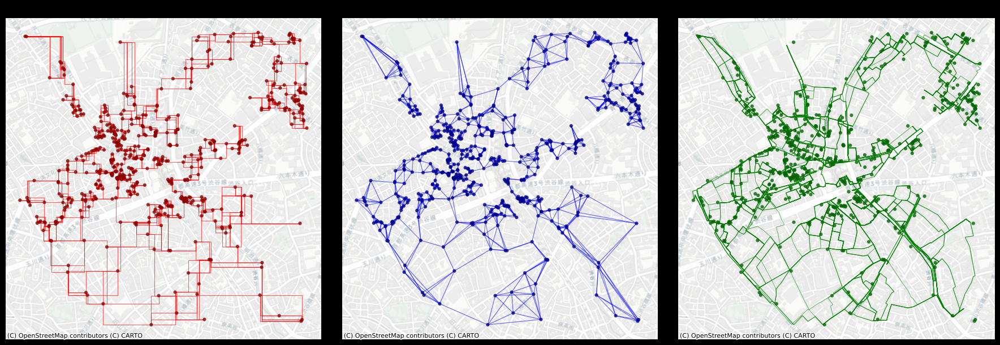

In [6]:
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot Manhattan distance KNN Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=knn_l1_edges,
    ax=axes[0],
    node_color='darkred',
    edge_color='red',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6
    )

ctx.add_basemap(axes[0], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)
axes[0].set_title('KNN Graph - Manhattan Distance', fontsize=12, fontweight='bold')
axes[0].set_axis_off()

# Plot Euclidean distance KNN Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=knn_l2_edges,
    ax=axes[1],
    node_color='darkblue', 
    edge_color='blue',
    markersize=20, 
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6
    )

ctx.add_basemap(axes[1], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)
axes[1].set_title('KNN Graph - Euclidean Distance', fontsize=12, fontweight='bold')
axes[1].set_axis_off()

# Plot Network distance KNN Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=knn_net_edges,
    ax=axes[2],
    node_color='darkgreen',
    edge_color='green',
    markersize=20, 
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6
    )

ctx.add_basemap(axes[2], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)
axes[2].set_title('KNN Graph - Network Distance', fontsize=12, fontweight='bold')
axes[2].set_axis_off()

plt.tight_layout()
plt.show()

You can obtain the output as `nx.Graph` object.

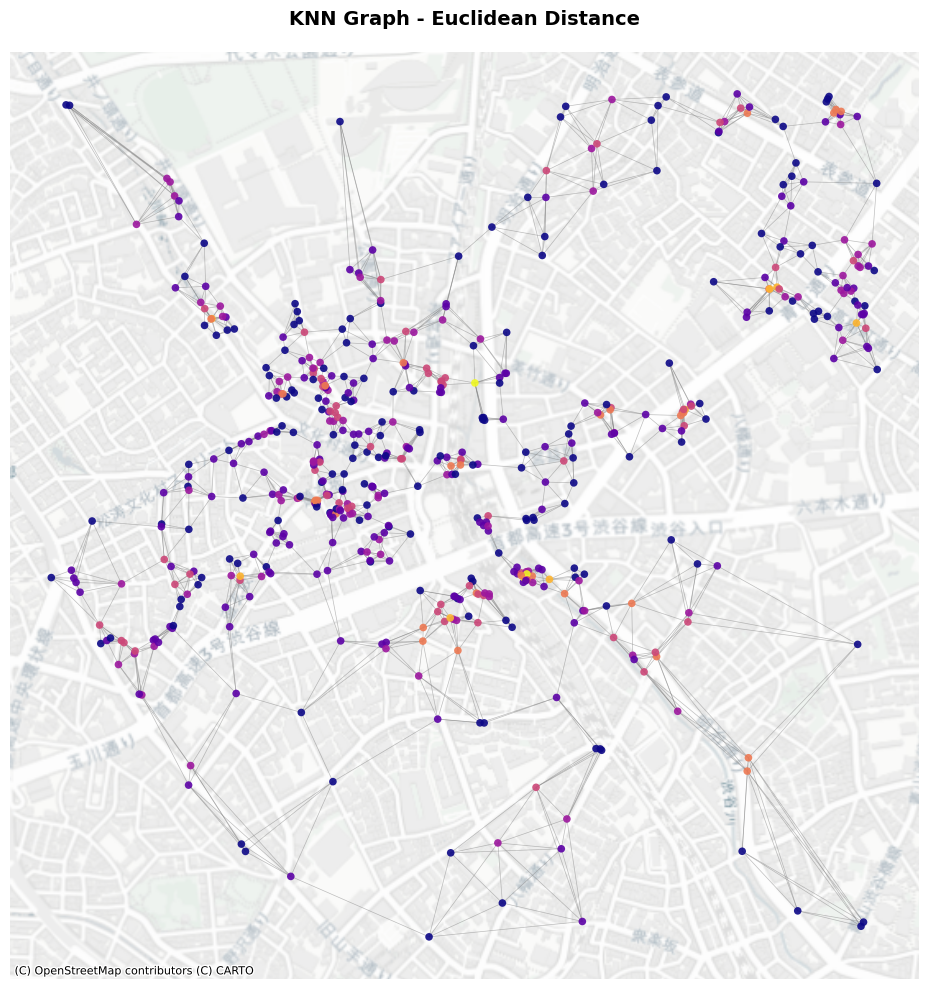

In [7]:
knn_l2_G = c2g.knn_graph(
    poi_gdf,
    distance_metric="euclidean",
    as_nx=True
)

fig, ax = plt.subplots(figsize=(12, 10))

c2g.plot_graph(
    graph=knn_l2_G,
    ax=ax,
    node_color=get_degree_colors(knn_l2_G),
    edge_color="grey",
    edge_alpha=0.5,
    edge_linewidth=0.5,
    node_alpha=0.9,
    markersize=30,
    bgcolor="white"
    )

if poi_gdf.crs:
    ctx.add_basemap(ax, crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

ax.set_title("KNN Graph - Euclidean Distance", fontsize=14, fontweight="bold", pad=20)
ax.set_axis_off()
plt.tight_layout()
plt.show()

In [8]:
HTML("""
<video controls style="width: 100%; max-width: 800px; height: auto;">
    <source src="../assets/videos/knn_graph.mp4" type="video/mp4">
</video>
""")

## 5. Delaunay Graph
Generate and plot a Delaunay triangulation graph of the POIs.

In [9]:
del_l1_nodes, del_l1_edges = c2g.delaunay_graph(
    poi_gdf,
    distance_metric="manhattan"
    )

del_l2_nodes, del_l2_edges = c2g.delaunay_graph(
    poi_gdf,
    distance_metric="euclidean"
    )

del_net_nodes, del_net_edges = c2g.delaunay_graph(
    poi_gdf,
    distance_metric="network",
    network_gdf=segments_gdf.to_crs(epsg=6677)
    )

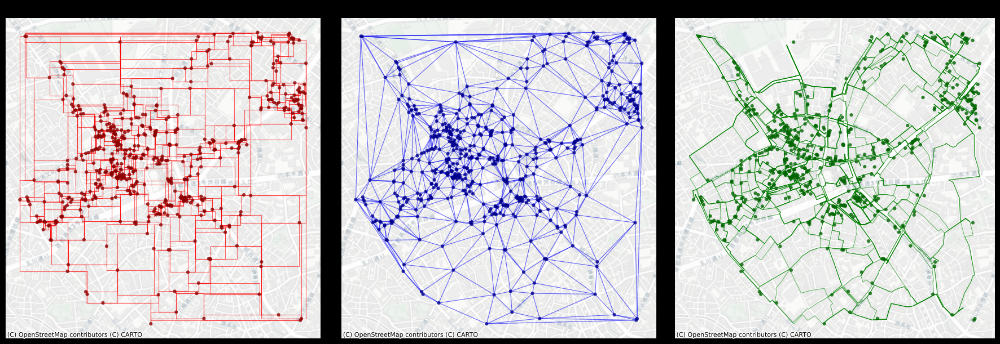

In [10]:
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot Manhattan distance Delaunay Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=del_l1_edges,
    ax=axes[0],
    node_color='darkred',
    edge_color='red',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6
    )

ctx.add_basemap(axes[0], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)
axes[0].set_title(
    'Delaunay Graph - Manhattan Distance', 
    fontsize=12, 
    fontweight='bold'
    )
axes[0].set_axis_off()

# Plot Euclidean distance Delaunay Graph
c2g.plot_graph(nodes=poi_gdf,
               edges=del_l2_edges,
               ax=axes[1],
               node_color='darkblue',
               edge_color='blue',
               markersize=20,
               node_alpha=0.8,
               edge_linewidth=0.8,
               edge_alpha=0.6
               )

ctx.add_basemap(axes[1], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)
axes[1].set_title(
    'Delaunay Graph - Euclidean Distance',
    fontsize=12, 
    fontweight='bold'
    )
axes[1].set_axis_off()

# Plot Network distance Delaunay Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=del_net_edges,
    ax=axes[2],
    node_color='darkgreen',
    edge_color='green',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6
    )

ctx.add_basemap(axes[2], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)
axes[2].set_title(
    'Delaunay Graph - Network Distance', 
    fontsize=12, 
    fontweight='bold'
    )
axes[2].set_axis_off()

plt.tight_layout()
plt.show()

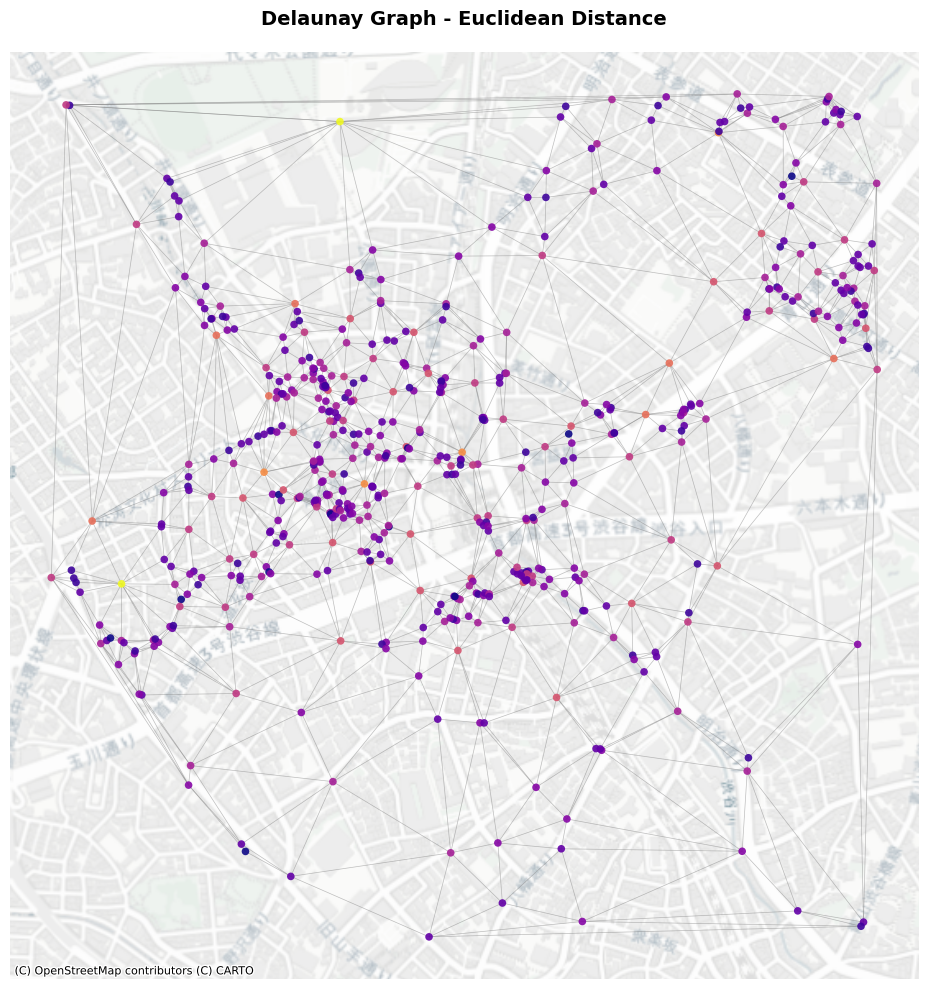

In [11]:
del_l2_G = c2g.delaunay_graph(
    poi_gdf,
    distance_metric="euclidean",
    as_nx=True
    )

fig, ax = plt.subplots(figsize=(12, 10))

c2g.plot_graph(
    graph=del_l2_G,
    ax=ax,
    node_color=get_degree_colors(del_l2_G),
    edge_color="grey",
    edge_alpha=0.5,
    edge_linewidth=0.5,
    node_alpha=0.9,
    markersize=30,
    bgcolor="white"
    )

if poi_gdf.crs:
    ctx.add_basemap(ax, crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

ax.set_title(
    "Delaunay Graph - Euclidean Distance", 
    fontsize=14,
    fontweight="bold",
    pad=20
    )

ax.set_axis_off()
plt.tight_layout()
plt.show()

## 6. Fixed Threshold Graph (Gilbert Graph)
Fixed Threshold Graph is a deterministic model to generate edges based on the Euclidean distance (Gilbert Graph is a generalised concept assuming points are randomly assigned). Given a parameter $r$ as radious, neighbours are connected if they are within the radious from a node.

In [12]:
fix_l1_nodes, fix_l1_edges = c2g.fixed_radius_graph(
    poi_gdf,
    distance_metric="manhattan",
    radius=100
    )

fix_l2_nodes, fix_l2_edges = c2g.fixed_radius_graph(
    poi_gdf,
    distance_metric="euclidean",
    radius=100
    )

fix_net_nodes, fix_net_edges = c2g.fixed_radius_graph(
    poi_gdf,
    distance_metric="network",
    radius=100,
    network_gdf=segments_gdf.to_crs(epsg=6677)
    )

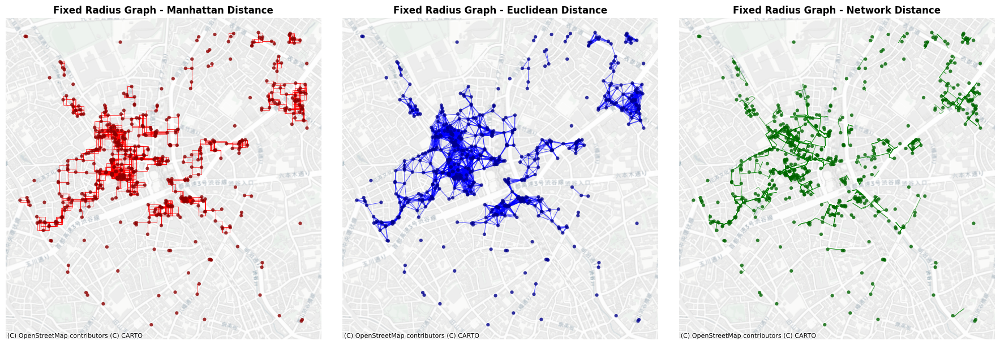

In [13]:
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot Manhattan distance Fixed Radius Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=fix_l1_edges,
    ax=axes[0],
    node_color='darkred',
    edge_color='red',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6,
    bgcolor="white"
    )

ctx.add_basemap(axes[0], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

axes[0].set_title(
    'Fixed Radius Graph - Manhattan Distance',
    fontsize=12,
    fontweight='bold'
    )
axes[0].set_axis_off()

# Plot Euclidean distance Fixed Radius Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=fix_l2_edges,
    ax=axes[1],
    node_color='darkblue',
    edge_color='blue',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6,
    bgcolor="white"
    )

ctx.add_basemap(axes[1], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

axes[1].set_title(
    'Fixed Radius Graph - Euclidean Distance',
    fontsize=12,
    fontweight='bold'
    )
axes[1].set_axis_off()

# Plot Network distance Fixed Radius Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=fix_net_edges,
    ax=axes[2],
    node_color='darkgreen',
    edge_color='green',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6,
    bgcolor="white"
    )

ctx.add_basemap(axes[2], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

axes[2].set_title(
    'Fixed Radius Graph - Network Distance',
    fontsize=12,
    fontweight='bold'
    )
axes[2].set_axis_off()

plt.tight_layout()
plt.show()

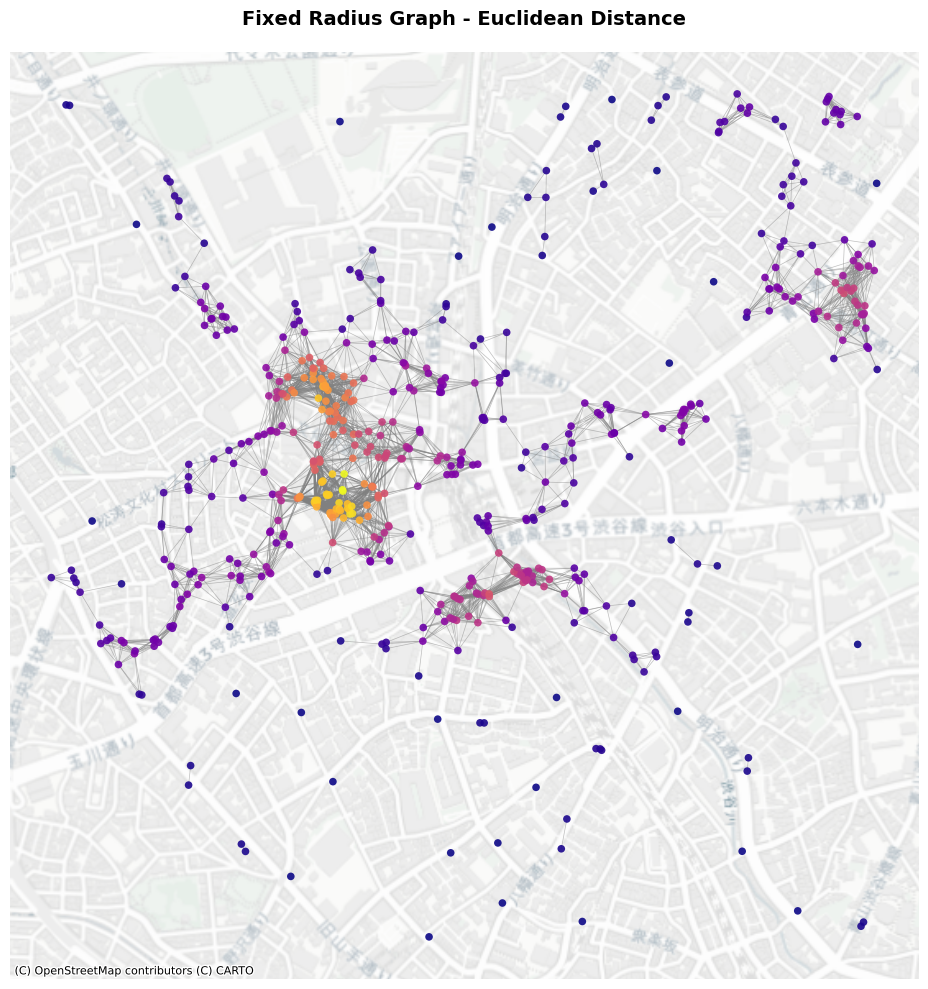

In [14]:
gil_l2_G = c2g.fixed_radius_graph(
    poi_gdf,
    distance_metric="euclidean",
    radius=100,
    as_nx=True
    )

fig, ax = plt.subplots(figsize=(12, 10))

c2g.plot_graph(
    graph=gil_l2_G,
    ax=ax,
    node_color=get_degree_colors(gil_l2_G),
    edge_color="grey",
    edge_alpha=0.5,
    edge_linewidth=0.5,
    node_alpha=0.9,
    markersize=30,
    bgcolor="white"
    )

if poi_gdf.crs:
    ctx.add_basemap(ax, crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

ax.set_title(
    "Fixed Radius Graph - Euclidean Distance",
    fontsize=14,
    fontweight="bold",
    pad=20
    )
ax.set_axis_off()
plt.tight_layout()
plt.show()

In [15]:
HTML("""
<video controls style="width: 100%; max-width: 800px; height: auto;">
    <source src="../assets/videos/gilbert_graph.mp4" type="video/mp4">
</video>
""")

## 7. Waxman Graph (Soft Random Geometry Model)
Waxman graph with adjustable $r_0$ (`r_0`) and $\beta$ (`beta`) as parameters. The probability of connection follows below: $$H_{ij} = \beta e^{-\frac{d_{ij}}{r_0}}$$

where $d_{ij}$ is the Euclidean distance between node $i$ an $j$; $r_0$ is the maximum distance between nodes; and $\beta$ denotes the scaling parameter.

In [16]:
wax_l1_nodes, wax_l1_edges = c2g.waxman_graph(
    poi_gdf,
    distance_metric="manhattan",
    r0=100,
    beta=0.5
    )
    
wax_l2_nodes, wax_l2_edges = c2g.waxman_graph(
    poi_gdf,
    distance_metric="euclidean",
    r0=100,
    beta=0.5
    )

wax_net_nodes, wax_net_edges = c2g.waxman_graph(
    poi_gdf,
    distance_metric="network",
    r0=100,
    beta=0.5,
    network_gdf=segments_gdf.to_crs(epsg=6677)
    )

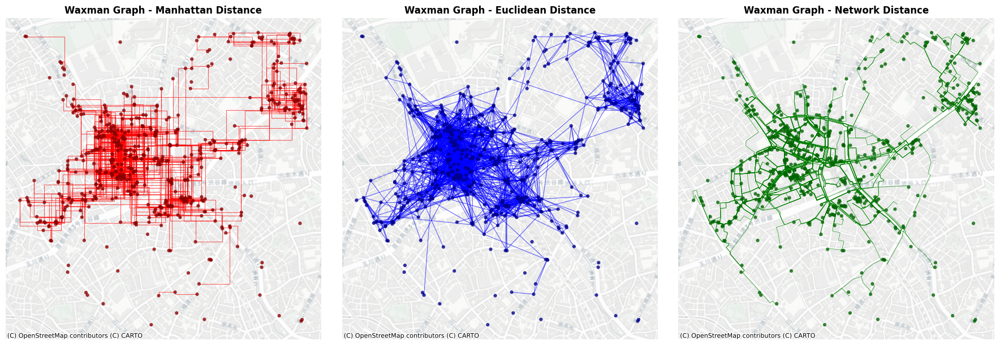

In [17]:
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot Manhattan distance Waxman Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=wax_l1_edges,
    ax=axes[0],
    node_color='darkred',
    edge_color='red',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6,
    bgcolor="white"
    )

ctx.add_basemap(axes[0], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

axes[0].set_title(
    'Waxman Graph - Manhattan Distance',
    fontsize=12,
    fontweight='bold'
    )
axes[0].set_axis_off()

# Plot Euclidean distance Waxman Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=wax_l2_edges,
    ax=axes[1],
    node_color='darkblue',
    edge_color='blue',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6,
    bgcolor="white"
    )

ctx.add_basemap(axes[1], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

axes[1].set_title(
    'Waxman Graph - Euclidean Distance',
    fontsize=12,
    fontweight='bold'
    )
axes[1].set_axis_off()

# Plot Network distance Waxman Graph
c2g.plot_graph(
    nodes=poi_gdf,
    edges=wax_net_edges,
    ax=axes[2],
    node_color='darkgreen',
    edge_color='green',
    markersize=20,
    node_alpha=0.8,
    edge_linewidth=0.8,
    edge_alpha=0.6,
    bgcolor="white"
    )

ctx.add_basemap(axes[2], crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

axes[2].set_title(
    'Waxman Graph - Network Distance',
    fontsize=12,
    fontweight='bold'
    )
axes[2].set_axis_off()

plt.tight_layout()
plt.show()

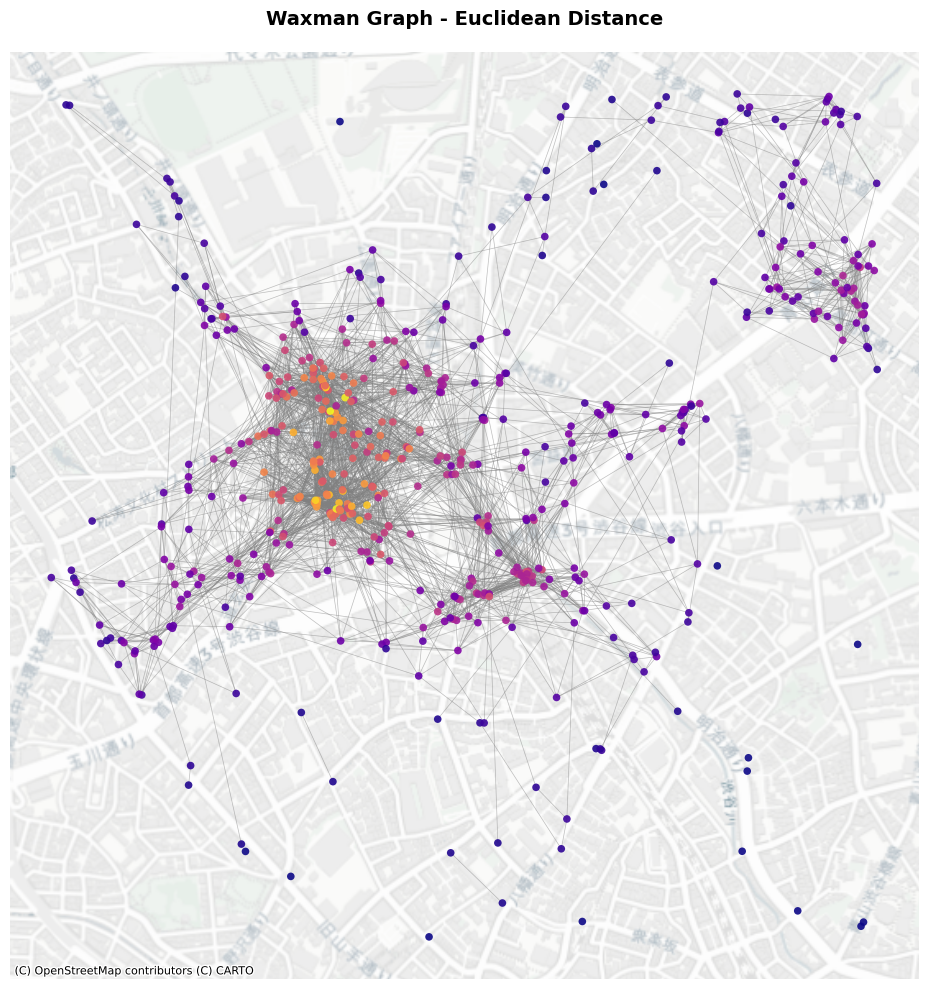

In [18]:
wax_l2_G = c2g.waxman_graph(
    poi_gdf,
    distance_metric="euclidean",
    r0=100,
    beta=0.5,
    as_nx=True
    )
fig, ax = plt.subplots(figsize=(12, 10))

c2g.plot_graph(
    graph=wax_l2_G,
    ax=ax,
    node_color=get_degree_colors(wax_l2_G),
    edge_color="grey",
    edge_alpha=0.5,
    edge_linewidth=0.5,
    node_alpha=0.9,
    markersize=30,
    bgcolor="white"
    )

if poi_gdf.crs:
    ctx.add_basemap(ax, crs=poi_gdf.crs, source=ctx.providers.CartoDB.Positron)

ax.set_title(
    "Waxman Graph - Euclidean Distance",
    fontsize=14,
    fontweight="bold",
    pad=20
    )
ax.set_axis_off()
plt.tight_layout()
plt.show()

In [19]:
HTML("""
<video controls style="width: 100%; max-width: 800px; height: auto;">
    <source src="../assets/videos/waxman_graph.mp4" type="video/mp4">
</video>
""")

## Other Available Proximity Graph Types

The c2g library provides several additional proximity-based graph generation methods beyond the ones demonstrated above:

### **Euclidean Minimum Spanning Tree (EMST)**
Creates a tree that connects all nodes with the minimum total edge weight using Euclidean distances. This ensures all nodes are connected with the fewest possible edges while minimizing total distance.

### **Gabriel Graph**
Two nodes are connected if no other node lies within the circle having these two nodes as diameter endpoints. This creates a sparser graph than Delaunay triangulation while maintaining good connectivity properties.

### **Relative Neighborhood Graph (RNG)**
Two nodes are connected if no other node is closer to both nodes than they are to each other. This creates an even sparser graph than Gabriel graph, often used in computational geometry and network analysis.

### **Key Characteristics**

- **EMST**: Guarantees connectivity with minimum total cost; useful for infrastructure planning
- **Gabriel Graph**: Good balance between sparsity and connectivity; useful for wireless networks
- **RNG**: Sparsest among proximity graphs; useful for identifying strongest local relationships
- **Fixed Radius**: Already demonstrated; creates connections within a specified distance threshold

### **Comparison of Graph Sparsity**
In terms of edge density (from most to least dense):
1. **Delaunay** - Most edges, captures all proximity relationships
2. **Gabriel** - Subset of Delaunay, removes longer edges in dense areas  
3. **RNG** - Subset of Gabriel, keeps only the strongest local connections
4. **EMST** - Sparsest connected graph, exactly n-1 edges for n nodes

These different graph types are particularly useful for modeling different types of spatial relationships and constraints in urban networks.

## 8. Bridge Nodes (Multi-layer Networks)
The `bridge_nodes` function creates directed proximity edges between different layers of nodes, enabling multi-layer network analysis. This is particularly useful for modeling complex urban systems where different types of entities (e.g., schools, hospitals, parks) interact with each other.

The function generates directed edges from every node in one layer to their nearest neighbors in another layer, using either KNN or fixed-radius methods.

In this example, three types of nodes (restaurants, hospitals, and commercials) are extracted from OpenStreetMap in Shibuya, Tokyo.

In [20]:
# Create different layers of POIs for multi-layer analysis
# Let's create hospitals and commercial POIs in addition to restaurants

# Hospitals layer
hospital_tags = {
    "amenity": [
        "hospital"]}

hospital_gdf = ox.features_from_point(
    (35.658514, 139.70133),  # Tokyo Tower coordinates
    tags=hospital_tags,
    dist=1000,  # Search radius in meters
    )

# Filter to include only nodes, not ways and relations
hospital_gdf = hospital_gdf[hospital_gdf.index.get_level_values("element") == "node"]
hospital_gdf = hospital_gdf.to_crs(epsg=6677)

# Commercial layer (shops)
commercial_tags = {
    "shop": True}

commercial_gdf = ox.features_from_point(
    (35.658514, 139.70133),  # Tokyo Tower coordinates
    tags=commercial_tags,
    dist=1000,  # Search radius in meters
    )

# Filter to include only nodes and take a subset to avoid too many points
commercial_gdf = commercial_gdf[commercial_gdf.index.get_level_values("element") == "node"]
commercial_gdf = commercial_gdf.to_crs(epsg=6677)

# Take a subset for better visualization
commercial_gdf = commercial_gdf.sample(min(30, len(commercial_gdf)), random_state=42)

print(f"Restaurants: {len(poi_gdf)} nodes")
print(f"Hospitals: {len(hospital_gdf)} nodes") 
print(f"Commercial: {len(commercial_gdf)} nodes")

Restaurants: 563 nodes
Hospitals: 6 nodes
Commercial: 30 nodes


A dictionary of nodes with their label names are made as `nodes_dict`. It is then passed to `bridge_nodes` to generate edges by proximity.

In [21]:
# Create a nodes dictionary for multi-layer network
nodes_dict = {
    "restaurants": poi_gdf,
    "hospitals": hospital_gdf,
    "commercial": commercial_gdf
}

# Generate proximity edges between layers using KNN method
proximity_nodes, proximity_edges = c2g.bridge_nodes(
    nodes_dict, 
    proximity_method="knn", 
    k=5,  # Connect to 5 nearest neighbors in each target layer
    distance_metric="euclidean"
)

print("Generated edge types:")
for edge_key in proximity_edges.keys():
    print(
        f"  {edge_key[0]} → {edge_key[2]}: {len(proximity_edges[edge_key])} edges"
        )

Generated edge types:
  restaurants → hospitals: 2815 edges
  restaurants → commercial: 2815 edges
  hospitals → restaurants: 30 edges
  hospitals → commercial: 30 edges
  commercial → restaurants: 150 edges
  commercial → hospitals: 150 edges


As shown in the plot, there are six types of proximity in the result.

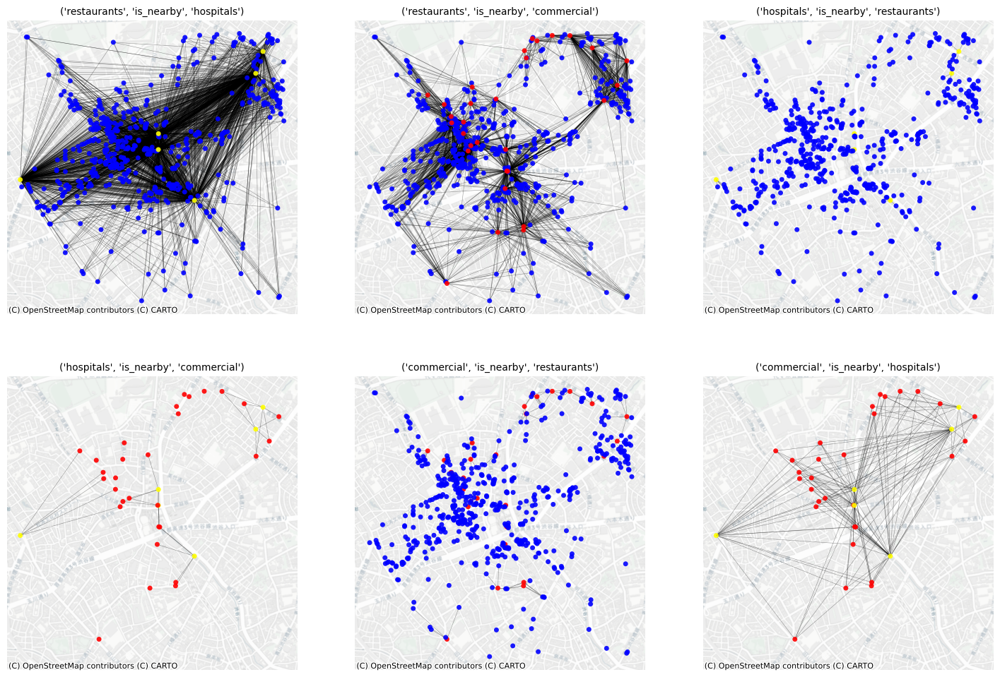

In [22]:
# Prepare for axes in advance
fig, ax = plt.subplots(2, 3, figsize=(18, 12))

# Visualize the multi-layer network connections
c2g.plot_graph(
    nodes=proximity_nodes,
    edges=proximity_edges,
    ax=ax,
    subplots=True,
    node_color={
        "restaurants": "blue",
        "hospitals": "yellow",
        "commercial": "red"
    },
    edge_color="black",
    edge_alpha=0.4,
    edge_linewidth=0.4,
    node_alpha=0.9,
    markersize={"restaurants": 25, "hospitals": 25, "commercial": 25},
    bgcolor="white",
    title_color="black"
)

# Set basemap
for a in ax.flatten():
    ctx.add_basemap(
        a,
        crs=proximity_nodes["restaurants"].crs,
        source=ctx.providers.CartoDB.Positron
        )
    a.set_axis_off()

In [23]:
# Compare with fixed-radius method
radius_nodes, radius_edges = c2g.bridge_nodes(
    nodes_dict,
    proximity_method="fixed_radius",
    radius=500,  # 500 meter radius
    distance_metric="euclidean"
)

print("\nFixed-radius method (500m radius):")
print("Generated edge types:")
total_knn_edges = sum(len(gdf) for gdf in proximity_edges.values())
total_radius_edges = sum(len(gdf) for gdf in radius_edges.values())

for edge_key in proximity_edges.keys():
    knn_count = len(proximity_edges[edge_key])
    radius_count = len(radius_edges[edge_key]) if edge_key in radius_edges else 0
    print(f"  {edge_key[0]} → {edge_key[2]}: KNN(k=2)={knn_count}, Fixed-radius(200m)={radius_count}")

print(f"\nTotal edges: KNN={total_knn_edges}, Fixed-radius={total_radius_edges}")


Fixed-radius method (500m radius):
Generated edge types:
  restaurants → hospitals: KNN(k=2)=2815, Fixed-radius(200m)=958
  restaurants → commercial: KNN(k=2)=2815, Fixed-radius(200m)=4967
  hospitals → restaurants: KNN(k=2)=30, Fixed-radius(200m)=958
  hospitals → commercial: KNN(k=2)=30, Fixed-radius(200m)=46
  commercial → restaurants: KNN(k=2)=150, Fixed-radius(200m)=4967
  commercial → hospitals: KNN(k=2)=150, Fixed-radius(200m)=46

Total edges: KNN=5990, Fixed-radius=11942


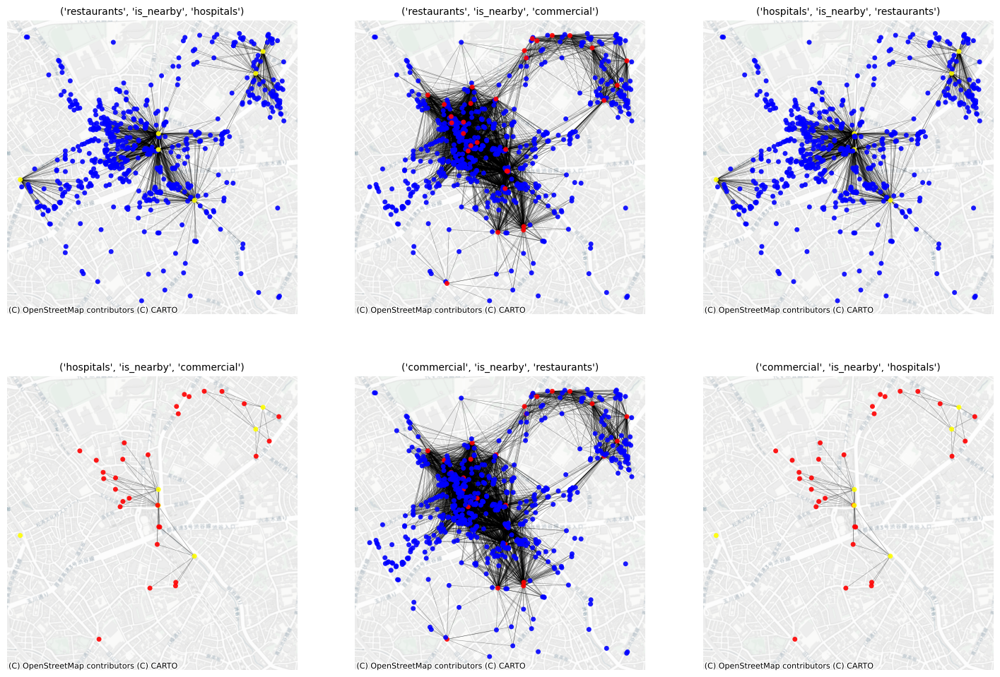

In [24]:
# Prepare for axes in advance
fig, ax = plt.subplots(2, 3, figsize=(18, 12))

# Visualize the multi-layer network connections
c2g.plot_graph(
    nodes=radius_nodes,
    edges=radius_edges,
    ax=ax,
    subplots=True,
    node_color={
        "restaurants": "blue",
        "hospitals": "yellow",
        "commercial": "red"
    },
    edge_color="black",
    edge_alpha=0.4,
    edge_linewidth=0.4,
    node_alpha=0.9,
    markersize={"restaurants": 25, "hospitals": 25, "commercial": 25},
    bgcolor="white",
    title_color="black"
)


# Set basemap
for a in ax.flatten():
    ctx.add_basemap(
        a,
        crs=radius_nodes["restaurants"].crs,
        source=ctx.providers.CartoDB.Positron
        )
    a.set_axis_off()

You can stack multiple layers of networks by `bridge_nodes` to construct a heterogenous graph. In another example below, streets network and bus transportation network will be stacked. For the behaviour of `load_gtfs` and `travel_summary_graph`, see [transportation.py](https://city2graph.net/api/transportation.html) for detailed documentation.

In this case, OpenStreetMap and GTFS from the Greater London are used as samples.

In [25]:
# Load GTFS data for travel summary graph generation
sample_gtfs_path = "./data/itm_london_gtfs.zip"
gtfs_data = c2g.load_gtfs(sample_gtfs_path)

# Generate travel summary graph for a specific date
travel_summary_nodes, travel_summary_edges = c2g.travel_summary_graph(
    gtfs_data,
    calendar_start="20250601",
    calendar_end="20250601"
    )

# Get the boundary polygon for London from OSMnx
london_boundary = ox.geocode_to_gdf("Greater London, UK").to_crs(epsg=27700)

# Project travel summary data to the same CRS as the bounding box
travel_summary_nodes = travel_summary_nodes.to_crs(epsg=27700)
travel_summary_edges = travel_summary_edges.to_crs(epsg=27700)

# Filter nodes and edges that are within the bounding box
nodes_in_bound = gpd.sjoin(
    travel_summary_nodes,
    london_boundary,
    how="inner"
    ).drop(columns=['index_right'])

edges_in_bound = gpd.sjoin(
    travel_summary_edges,
    london_boundary,
    how="inner"
    ).drop(columns=['index_right'])

# Update the original variables with the filtered data
travel_summary_nodes = nodes_in_bound
travel_summary_edges = edges_in_bound

travel_summary_edges = travel_summary_edges[
    travel_summary_edges.index.get_level_values('from_stop_id').isin(travel_summary_nodes.index) &
    travel_summary_edges.index.get_level_values('to_stop_id').isin(travel_summary_nodes.index)
]

print(f"Nodes within boundary: {len(travel_summary_nodes)}")
print(f"Edges within boundary: {len(travel_summary_edges)}")


Nodes within boundary: 20220
Edges within boundary: 25182


In [26]:
# Download London's street network as a GeoDataFrame
london_graph = ox.graph_from_place("Greater London, UK", network_type="drive")
street_nodes, street_edges = c2g.nx_to_gdf(london_graph)

# Add these lines to project the nodes as well
street_nodes.to_crs(epsg=27700, inplace=True)
travel_summary_nodes.to_crs(epsg=27700, inplace=True)

street_edges.to_crs(epsg=27700, inplace=True)
travel_summary_edges.to_crs(epsg=27700, inplace=True)

Now, `bridge_nodes` is applied to the two types of nodes.

In [27]:
proximity_nodes, proximity_edges = c2g.bridge_nodes(
    {"street": street_nodes,
     "bus": travel_summary_nodes}
    )

The two types of edges `('bus', 'is_nearby', 'street')` and `('street', 'is_nearby', 'bus')` are visualized.

array([<Axes: title={'center': "('street', 'is_nearby', 'bus')"}>,
       <Axes: title={'center': "('bus', 'is_nearby', 'street')"}>],
      dtype=object)

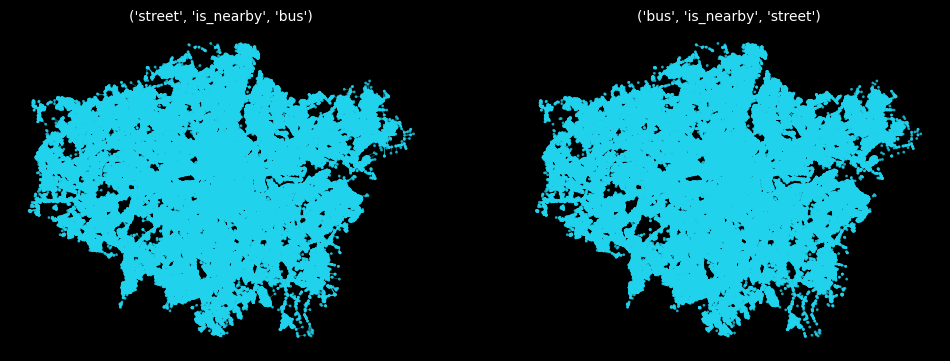

In [28]:
c2g.plot_graph(
    nodes=proximity_nodes,
    edges=proximity_edges,
    ncols=2
)

In addition to the obtained edges by proximity, `street_edges` and `travel_summary_edges` are registered as two meta-paths of the heterogenous graph. `proximity_nodes` and `proximity_edges` are finally used to constructed a `HeteroData` for PyTorch Geometric by `gdf_to_pyg`.

In [29]:
# Convert proximity_nodes and proximity_edges to HeteroData using gdf_to_pyg
hetero_data = c2g.gdf_to_pyg(proximity_nodes, proximity_edges)

In [30]:
print("HeteroData structure:")
print(hetero_data)
print("\nNode types and their counts:")
for node_type in hetero_data.node_types:
    print(f"  {node_type}: {hetero_data[node_type].x.shape[0]} nodes")
print("\nEdge types and their counts:")
for edge_type in hetero_data.edge_types:
    print(f"  {edge_type}: {hetero_data[edge_type].edge_index.shape[1]} edges")

HeteroData structure:
HeteroData(
  crs=EPSG:27700,
  graph_metadata=<city2graph.base.GraphMetadata object at 0x16b4c6f70>,
  street={
    x=[130474, 0],
    pos=[130474, 2],
  },
  bus={
    x=[20220, 0],
    pos=[20220, 2],
  },
  (street, is_nearby, bus)={
    edge_index=[2, 130474],
    edge_attr=[130474, 0],
  },
  (bus, is_nearby, street)={
    edge_index=[2, 20220],
    edge_attr=[20220, 0],
  }
)

Node types and their counts:
  street: 130474 nodes
  bus: 20220 nodes

Edge types and their counts:
  ('street', 'is_nearby', 'bus'): 130474 edges
  ('bus', 'is_nearby', 'street'): 20220 edges


## 9. Contiguity Graph (Spatial Weights Matrix)

`contiguity_graph` creates spatial networks from polygon geometries based on adjacency relationships. Unlike point-based proximity graphs, contiguity graphs connect polygons that share boundaries, making them essential for analyzing administrative boundaries, urban districts, land parcels, and other areal units.

This approach is particularly valuable for:
- **Urban planning**: Analyzing connectivity between neighborhoods, districts, or zones
- **Administrative analysis**: Understanding relationships between electoral districts, census areas, or municipal boundaries  
- **Land use studies**: Examining adjacency patterns in zoning, parcels, or development areas
- **Spatial autocorrelation**: Measuring how attributes cluster across contiguous geographic units
- **Network analysis of regions**: Computing centrality measures for administrative or natural areas

The function supports two contiguity rules:
- **Queen contiguity**: Polygons sharing any boundary (edges or vertices) are connected
- **Rook contiguity**: Only polygons sharing edges (not just corner points) are connected

### Loading Sample Data

First, let's load a real-world dataset of London administrative wards to demonstrate contiguity analysis on actual geographic boundaries. This dataset provides an excellent example of how `contiguity_graph` works with complex administrative polygons that have realistic adjacency patterns.

The `contiguity_graph` function is specifically designed to handle polygon data and uses libpysal's robust spatial weights functionality to accurately determine which polygons are neighbors based on shared boundaries.

In [31]:
import geopandas as gpd

# Load London wards shapefile and run contiguity_graph
wards_path = "./data/London-wards-2018/London-wards-2018_ESRI/London_Ward_CityMerged.shp"

# Read
wards = gpd.read_file(wards_path)
print("Wards loaded:", len(wards), ", CRS:", wards.crs)

Wards loaded: 633 , CRS: EPSG:27700


### Generating Queen and Rook Contiguity Graphs

Now we'll create both Queen and Rook contiguity graphs from the London wards data. The `contiguity_graph` function leverages libpysal's robust spatial weights functionality to accurately determine adjacency relationships between polygons, making it highly reliable for complex geographic data.

**Key differences between contiguity rules:**
- **Queen contiguity** typically produces more edges since it considers both edge and vertex adjacency (like a chess queen's movement)
- **Rook contiguity** is more restrictive, only connecting polygons that share actual boundary edges (like a chess rook's movement)

This distinction is crucial for different types of spatial analysis - Queen contiguity captures more nuanced neighborhood relationships, while Rook contiguity focuses on direct physical connections.

In [32]:
# Queen contiguity
wn_q_nodes, wn_q_edges = c2g.contiguity_graph(wards, contiguity="queen", as_nx=False)

# Rook contiguity
wn_r_nodes, wn_r_edges = c2g.contiguity_graph(wards, contiguity="rook", as_nx=False)

print(f"Queen — wards: {len(wn_q_nodes)}, edges: {len(wn_q_edges)}")
print(f"Rook  — wards: {len(wn_r_nodes)}, edges: {len(wn_r_edges)}")

Queen — wards: 633, edges: 1865
Rook  — wards: 633, edges: 1797


As seen below, the output properly contains the contiguity.

In [35]:
wn_q_edges

weight                                           geometry
0   6    2293.180212  LINESTRING (517652.344 162339.161, 518064.389 ...
1   3    1477.089130  LINESTRING (519124.935 165300.016, 520118.14 1...
    6    1273.490894  LINESTRING (519124.935 165300.016, 518064.389 ...
    7    1416.550272  LINESTRING (519124.935 165300.016, 518303.176 ...
2   7    1200.560634  LINESTRING (519108.407 167344.325, 518303.176 ...
...              ...                                                ...
626 631  1157.332290  LINESTRING (548034.582 186790.44, 548124.872 1...
627 628  1416.092005  LINESTRING (549443.328 186492.423, 548566.274 ...
    629  1402.322724  LINESTRING (549443.328 186492.423, 550789.867 ...
    631  1571.845404  LINESTRING (549443.328 186492.423, 548124.872 ...
628 630  1897.904259  LINESTRING (548566.274 187604.22, 548359.712 1...

[1865 rows x 2 columns]

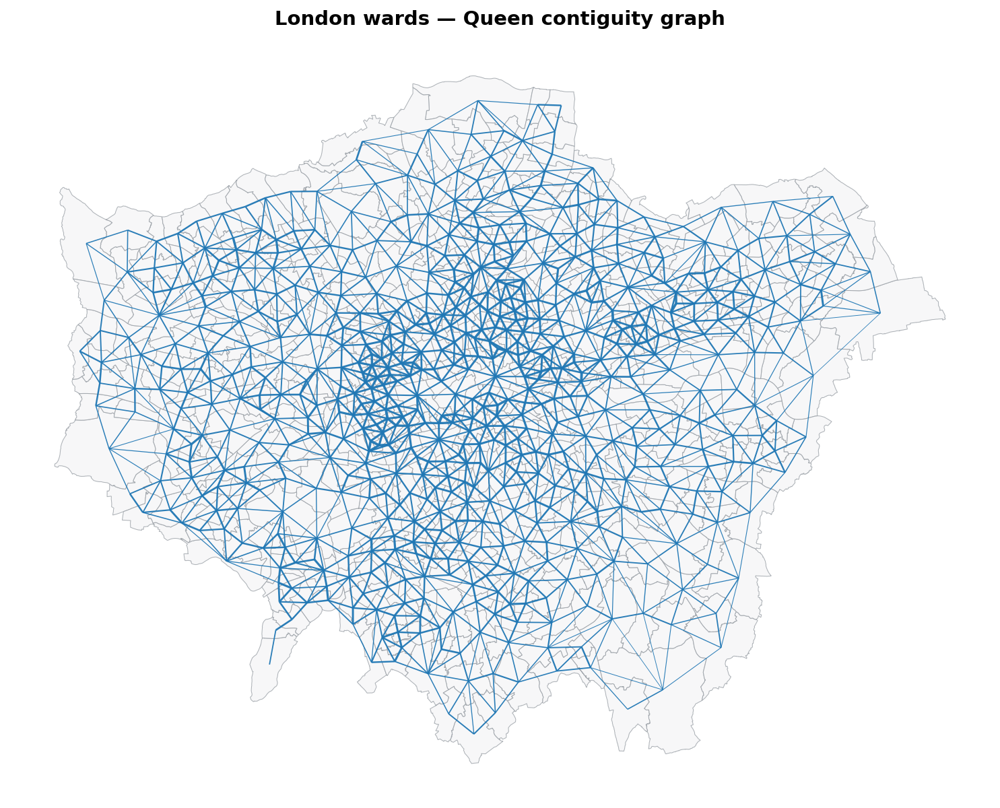

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10), dpi=150)

# Normalize line widths from edge weights
lw = 0.5 + 2.0 * (w - w.min()) / (w.max() - w.min() if w.max() > w.min() else 1.0)


# Use c2g.plot_graph for consistent plotting
# For contiguity, we treat wards as nodes and the adjacency as edges
c2g.plot_graph(
    nodes=wn_q_nodes,
    edges=wn_q_edges,
    ax=ax,
    bgcolor="white",
    
    # Node styling (Wards polygons)
    node_color="#f5f5f7",   # near-white fill
    node_edgecolor="#9aa0a6", # soft gray outline
    
    # Edge styling (Contiguity links)
    edge_color="#1f77b4",   # vivid blue
    edge_linewidth=1/lw,
    edge_alpha=0.95,
    edge_zorder=3
)

# Focus on content, remove axes clutter
ax.set_axis_off()
ax.set_title("London wards — Queen contiguity graph", fontsize=14, fontweight="bold", pad=12)

plt.tight_layout()
plt.show()

### Computing Network Centrality Measures

One of the key advantages of contiguity graphs is their ability to reveal the structural importance of different geographic units through network centrality measures. The `contiguity_graph` function seamlessly integrates with NetworkX, enabling sophisticated spatial network analysis.

Here we compute three fundamental centrality metrics that provide different insights into urban structure:

- **Degree centrality**: Measures how many neighbors each ward has (local connectivity) - identifies areas with many adjacent districts
- **Betweenness centrality**: Identifies wards that serve as bridges between different parts of London - crucial for understanding urban connectivity patterns
- **Closeness centrality**: Measures how easily accessible each ward is from all other wards - important for accessibility analysis

These metrics can be easily calculated using NetworkX, and c2g enables smooth transitions between NetworkX graphs and GeoPandas objects through the `nx_to_gdf` function, making spatial analysis workflows highly efficient.

In [41]:
# Basic connectivity using NetworkX
G_wards = c2g.contiguity_graph(wards, contiguity="queen", as_nx=True)

degree_centrality = nx.degree_centrality(G_wards)
nx.set_node_attributes(G_wards, degree_centrality, 'degree_centrality')

betweenness_centrality = nx.betweenness_centrality(G_wards)
nx.set_node_attributes(G_wards, betweenness_centrality, 'betweenness_centrality')

closeness_centrality = nx.closeness_centrality(G_wards)
nx.set_node_attributes(G_wards, closeness_centrality, 'closeness_centrality')

wn_q_nodes, wn_q_edges = c2g.nx_to_gdf(G_wards)

`contiguity_graph` preserves all original polygon attributes while adding computed centrality measures.

In [42]:
wn_q_nodes.head()

,NAME,GSS_CODE,DISTRICT,LAGSSCODE,HECTARES,NONLD_AREA,geometry,degree_centrality,betweenness_centrality,closeness_centrality
0,Chessington South,E05000405,Kingston upon Thames,E09000021,755.173,0.0,"POLYGON ((516401.596 160201.802, 516407.302 16...",0.001582,0.000000,0.070004
1,Tolworth and Hook Rise,E05000414,Kingston upon Thames,E09000021,259.464,0.0,"POLYGON ((519552.998 164295.6, 519508.096 1643...",0.004747,0.006319,0.081359
2,Berrylands,E05000401,Kingston upon Thames,E09000021,145.390,0.0,"POLYGON ((518107.499 167303.399, 518114.301 16...",0.009494,0.002797,0.088157
3,Alexandra,E05000400,Kingston upon Thames,E09000021,268.506,0.0,"POLYGON ((520336.7 165105.498, 520332.198 1651...",0.009494,0.011225,0.087924
4,Beverley,E05000402,Kingston upon Thames,E09000021,187.821,0.0,"POLYGON ((521201.203 169275.505, 521204.303 16...",0.014241,0.036149,0.095700


Now we can see the distribution of each centrality. As shown below, each distribution has unique pattern. 

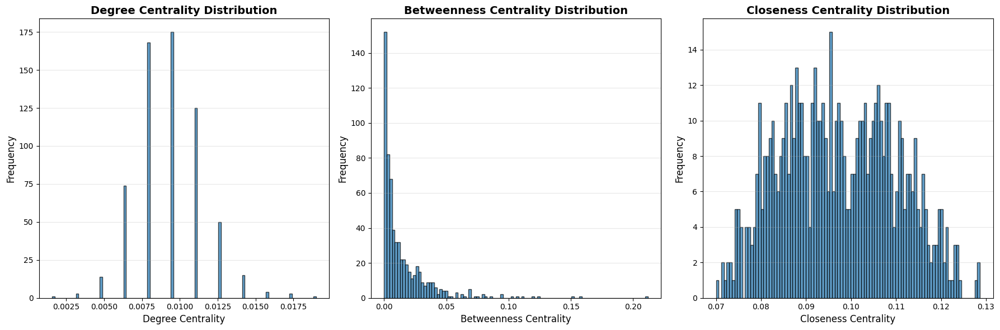

In [43]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot Degree Centrality
axes[0].hist(wn_q_nodes['degree_centrality'], bins=100, edgecolor='black', alpha=0.7)
axes[0].set_title('Degree Centrality Distribution', fontsize=14, fontweight='bold')
axes[0].set_xlabel('Degree Centrality', fontsize=12)
axes[0].set_ylabel('Frequency', fontsize=12)
axes[0].grid(axis='y', alpha=0.3)

# Plot Betweenness Centrality
axes[1].hist(wn_q_nodes['betweenness_centrality'], bins=100, edgecolor='black', alpha=0.7)
axes[1].set_title('Betweenness Centrality Distribution', fontsize=14, fontweight='bold')
axes[1].set_xlabel('Betweenness Centrality', fontsize=12)
axes[1].set_ylabel('Frequency', fontsize=12)
axes[1].grid(axis='y', alpha=0.3)

# Plot Closeness Centrality
axes[2].hist(wn_q_nodes['closeness_centrality'], bins=100, edgecolor='black', alpha=0.7)
axes[2].set_title('Closeness Centrality Distribution', fontsize=14, fontweight='bold')
axes[2].set_xlabel('Closeness Centrality', fontsize=12)
axes[2].set_ylabel('Frequency', fontsize=12)
axes[2].grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

By plotting the spatial distribution as choropleth maps, we can visualize how centrality measures vary across London wards, revealing patterns of urban connectivity and importance. 

- **Degree Centrality** (left) shows local connectivity, with higher values (darker colors) in densely connected central areas like the City of London and parts of Westminster, indicating wards with many adjacent neighbors. Peripheral wards have lower values, reflecting fewer connections.

- **Closeness Centrality** (middle) measures accessibility, with central wards (e.g., around the Thames) scoring higher (brighter colors), as they are closer to all other wards in the network. Outlying areas show lower values, highlighting reduced overall reachability.

- **Betweenness Centrality** (right) identifies bridge wards that connect different parts of London, with the highest values (darker colors) concentrated in central hubs like the City of London and key transport corridors. This pattern differs from the others by emphasizing wards that facilitate flow between regions.

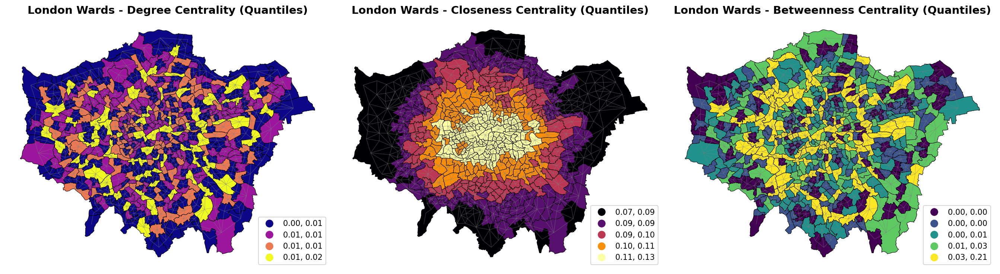

In [44]:
import matplotlib.pyplot as plt

# Plot the wards with centrality measures as choropleth maps using quantile classification
fig, axes = plt.subplots(1, 3, figsize=(18, 6), dpi=150)

# Choropleth map for degree centrality
wn_q_nodes.plot(
    column='degree_centrality',
    ax=axes[0],
    cmap='plasma',
    scheme='quantiles',
    k=5,
    legend=True,
    legend_kwds={'loc': 'lower right'},
    edgecolor='black',
    linewidth=0.5
)
axes[0].set_title('London Wards - Degree Centrality (Quantiles)', fontsize=14, fontweight='bold')
axes[0].set_axis_off()

# Choropleth map for closeness centrality
wn_q_nodes.plot(
    column='closeness_centrality',
    ax=axes[1],
    cmap='inferno',
    scheme='quantiles',
    k=5,
    legend=True,
    legend_kwds={'loc': 'lower right'},
    edgecolor='black',
    linewidth=0.5
)
axes[1].set_title('London Wards - Closeness Centrality (Quantiles)', fontsize=14, fontweight='bold')
axes[1].set_axis_off()

# Choropleth map for betweenness centrality
wn_q_nodes.plot(
    column='betweenness_centrality',
    ax=axes[2],
    cmap='viridis',
    scheme='quantiles',
    k=5,
    legend=True,
    legend_kwds={'loc': 'lower right'},
    edgecolor='black',
    linewidth=0.5
)
axes[2].set_title('London Wards - Betweenness Centrality (Quantiles)', fontsize=14, fontweight='bold')
axes[2].set_axis_off()

# Add contiguity edges to all subplots for context
for ax in axes:
    wn_q_edges.plot(
        ax=ax,
        color='gray',
        linewidth=0.5,
        alpha=0.5
    )

plt.tight_layout()
plt.show()

## 10. Group Nodes

`group_nodes` function can generate spatial relationships between polygon geometries (e.g., administrative boundaries like wards) and point geometries (e.g., bus stations) based on spatial predicates. It creates directed edges from polygons to points that satisfy the specified predicate, enabling analysis of hierarchical or containment-based graphs. This is particularly useful for modeling relationships where points are contained within polygons, such as POIs within administrative boundaries.

### Key Features:
- **Spatial Predicates**: Supports predicates like `"covered_by"` (default), `"intersects"`, `"within"`, etc., to define how points relate to polygons.
- **Distance Metrics**: Can incorporate distance calculations (e.g., `"euclidean"`, `"manhattan"`, `"network"`) when a network GeoDataFrame is provided, though primarily used for containment-based relationships.
- **Output**: Returns dictionaries of nodes and edges, compatible with heterogeneous graph construction for PyTorch Geometric.
- **Applications**: Ideal for urban planning, accessibility analysis, and multi-scale network modeling where polygon-point interactions are key.

### Grouping by Euclidean Distance 
For the demonstration, we use the previous outputs of nodes from queen-based contiguity graph (polygon: wards) and travel summary graph (point: bus station). In this case, `distance_metric=euclidean` is chosen for the distance calculation.

In [45]:
# Generate proximity edges between wards (polygons) and bus stations (points) using group_nodes
proximity_nodes, proximity_edges = c2g.group_nodes(
    wn_q_nodes,  # polygons_gdf (wards)
    travel_summary_nodes,  # points_gdf (bus stations)
    distance_metric="euclidean", # Distance metric
    predicate="covered_by"  # Default predicate for containment
)

print("Generated edge types:")
for edge_key in proximity_edges.keys():
    print(f"  {edge_key[0]} → {edge_key[2]}: {len(proximity_edges[edge_key])} edges")


Generated edge types:
  polygon → point: 20220 edges


As seen in the visualization below, the point nodes are grouped by the polygon nodes, constructing edges between them.

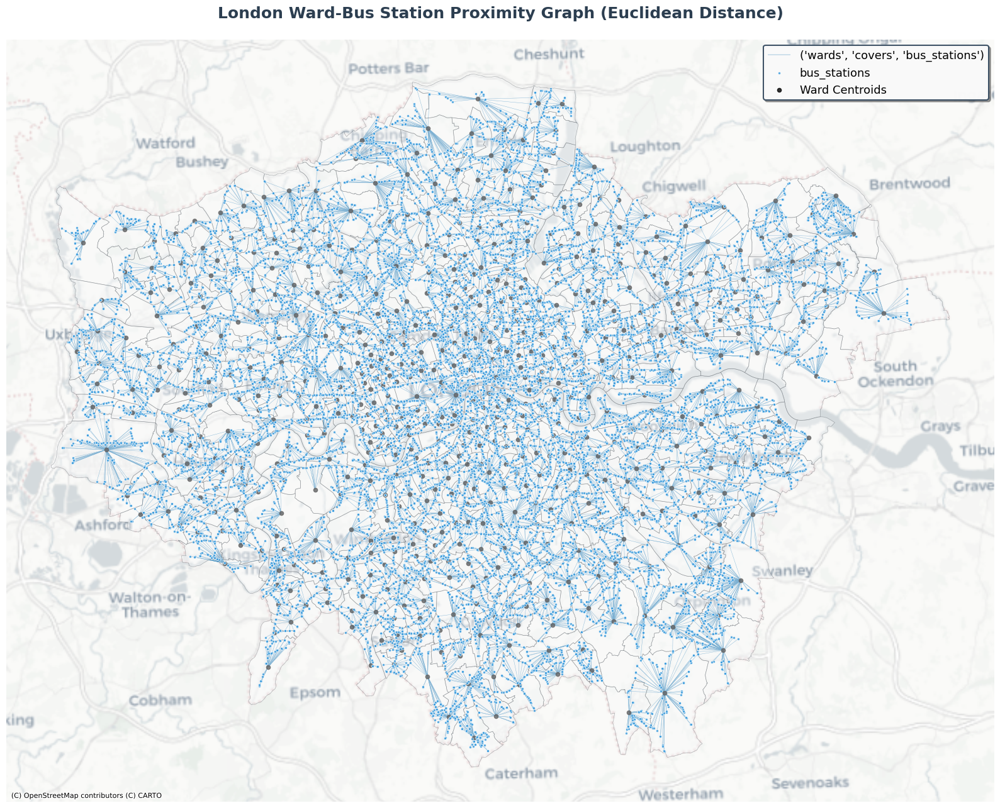

In [46]:
# Plot the proximity graph with enhanced styling and beautiful colors
fig, ax = plt.subplots(1, 1, figsize=(16, 14))

# Create dictionaries for plotting
plot_nodes = {
    'wards': proximity_nodes['polygon'],
    'bus_stations': proximity_nodes['point']
}

plot_edges = {
    ('wards', 'covers', 'bus_stations'): proximity_edges[('polygon', 'covers', 'point')]
}

c2g.plot_graph(
    nodes=plot_nodes,
    edges=plot_edges,
    ax=ax,
    node_color={
        'wards': '#F8F9FA',
        'bus_stations': '#3498DB'
    },
    node_edgecolor={
        'wards': '#495057', 
        'bus_stations': 'white'
    },
    node_alpha={
        'wards': 0.4,
        'bus_stations': 0.8
    },
    markersize={'bus_stations': 8},
    edge_color='#2980B9',
    edge_linewidth=0.3,
    edge_alpha=1,
    bgcolor="white"
)

# Add centroids of polygons with black 'x' markers
centroids = proximity_nodes['polygon'].centroid
ax.scatter(centroids.x, centroids.y, color='black', s=20, alpha=0.8, label='Ward Centroids')

# Add basemap with a clean, modern style
ctx.add_basemap(ax, crs=proximity_nodes['polygon'].crs, source=ctx.providers.CartoDB.Positron)

# Enhanced title and styling
ax.set_title('London Ward-Bus Station Proximity Graph (Euclidean Distance)', 
             fontsize=18, fontweight='bold', pad=25, color='#2C3E50')

# Beautiful legend with custom styling
legend = ax.legend(
    loc='upper right', 
    fontsize=13, 
    framealpha=0.95,
    fancybox=True,
    shadow=True,
    edgecolor='#34495E',
    facecolor='white'
)
legend.get_frame().set_linewidth(1.5)

ax.set_aspect('equal')
ax.axis('off')

# Add subtle border around the plot
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.show()

### Grouping by Network Distance
We can use network distance for the calculation of `group_nodes`, in the same way as the other functions in `proximity.py`. In this case, we use streets from OpenStreetMap via `osmnx`.

In [ ]:
G_streets = ox.graph_from_place("Greater London, UK", network_type="all")

street_nodes, street_edges = c2g.nx_to_gdf(G_streets)
street_edges.to_crs(epsg=27700, inplace=True)

In [41]:
# Generate proximity edges between wards (polygons) and bus stations (points) using group_nodes
proximity_net_nodes, proximity_net_edges = c2g.group_nodes(
    wn_q_nodes,  # polygons_gdf (wards)
    travel_summary_nodes,  # points_gdf (bus stations)
    distance_metric="network", # Network distance metric
    network_gdf=street_edges,  # Network for distance calculations (not used for containment
    predicate="covered_by"  # Default predicate for containment
)

print("Generated edge types:")
for edge_key in proximity_net_edges.keys():
    print(f"  {edge_key[0]} → {edge_key[2]}: {len(proximity_net_edges[edge_key])} edges")

Generated edge types:
  polygon → point: 20220 edges


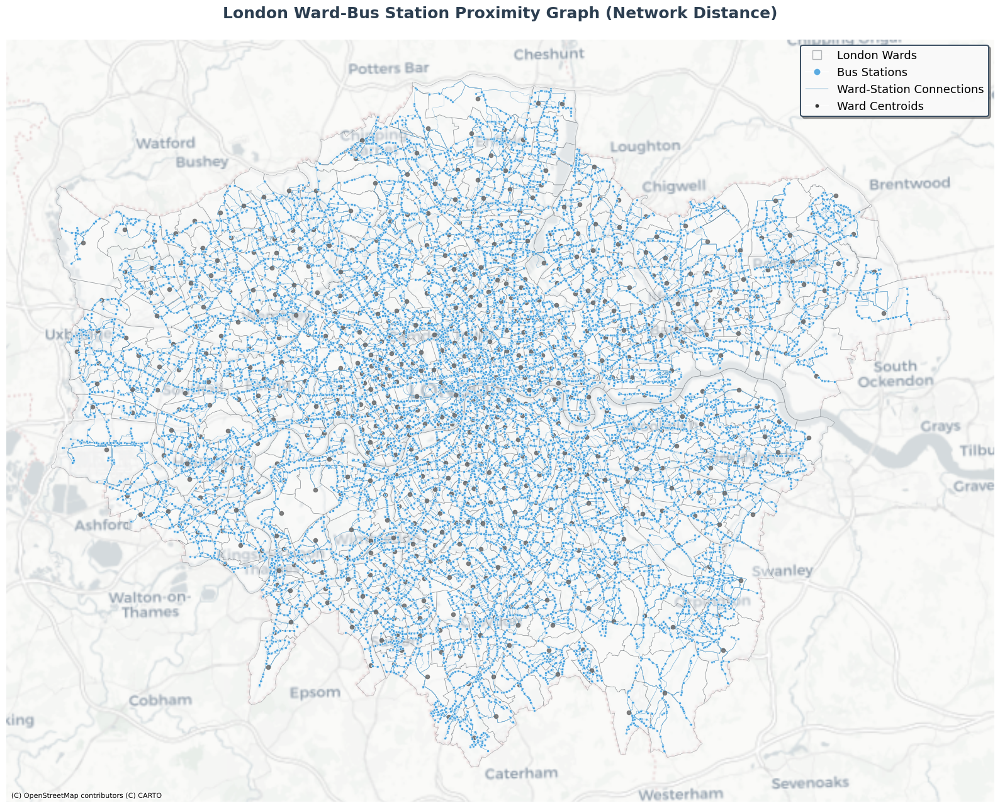

In [42]:
# Plot the proximity graph with enhanced styling and beautiful colors
fig, ax = plt.subplots(1, 1, figsize=(16, 14))

# Use c2g.plot_graph for consistent styling
c2g.plot_graph(
    nodes=proximity_net_nodes,
    edges=proximity_net_edges,
    ax=ax,
    node_color={
        'polygon': '#F8F9FA',
        'point': '#3498DB'
    },
    node_edgecolor={
        'polygon': '#495057',
        'point': 'white'
    },
    node_alpha={
        'polygon': 0.4,
        'point': 0.8
    },
    markersize={'point': 8},
    edge_color='#2980B9',
    edge_linewidth=0.3,
    edge_alpha=1,
    bgcolor="white"
)

# Add centroids of polygons with black 'x' markers
centroids = proximity_net_nodes['polygon'].centroid
ax.scatter(centroids.x, centroids.y, color='black', s=20, alpha=0.8, label='Ward Centroids')

# Add basemap with a clean, modern style
ctx.add_basemap(ax, crs=proximity_net_nodes['polygon'].crs, source=ctx.providers.CartoDB.Positron)

# Enhanced title and styling
ax.set_title('London Ward-Bus Station Proximity Graph (Network Distance)', 
             fontsize=18, fontweight='bold', pad=25, color='#2C3E50')

# Beautiful legend with custom styling
from matplotlib.lines import Line2D
legend_elements = [
    Line2D([0], [0], marker='s', color='w', label='London Wards',
           markerfacecolor='#F8F9FA', markersize=10, markeredgecolor='#495057', alpha=0.4),
    Line2D([0], [0], marker='o', color='w', label='Bus Stations',
           markerfacecolor='#3498DB', markersize=8, markeredgecolor='white', alpha=0.8),
    Line2D([0], [0], color='#2980B9', lw=0.3, label='Ward-Station Connections'),
    Line2D([0], [0], marker='o', color='w', label='Ward Centroids',
           markerfacecolor='black', markersize=5, alpha=0.8)
]
legend = ax.legend(
    handles=legend_elements,
    loc='upper right', 
    fontsize=13, 
    framealpha=0.95,
    fancybox=True,
    shadow=True,
    edgecolor='#34495E',
    facecolor='white'
)
legend.get_frame().set_linewidth(1.5)

ax.set_aspect('equal')
ax.set_axis_off()

# Add subtle border around the plot
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.show()

The outputs from `group_nodes` can be used for constructing a heterogeneous graph where multiple types of nodes and edges coexist. Especially for for `torch_geometric`, `gdf_to_pyg` (or if converted to `nx` objects: `nx_to_pyg`) supports such operations:

In [47]:
# Combine nodes and edges into dictionaries for heterogeneous graph
combined_nodes = {
    'wards': proximity_nodes["polygon"],
    'bus_stations': proximity_nodes["point"]
}

combined_edges = {
    ('wards', 'is_contiguous_with', 'wards'): wn_q_edges,
    ('wards', 'covers', 'bus_stations'): proximity_edges[('polygon', 'covers', 'point')],
    ('bus_stations', 'connects', 'bus_stations'): travel_summary_edges
}

# Create heterogeneous graph using city2graph
wards_bus_hetero_data = c2g.gdf_to_pyg(combined_nodes, combined_edges)

print("Combined Heterogeneous Graph Structure:")
print(wards_bus_hetero_data)
print("\nNode types and their counts:")
for node_type in wards_bus_hetero_data.node_types:
    print(f"  {node_type}: {wards_bus_hetero_data[node_type].x.shape[0]} nodes")
print("\nEdge types and their counts:")
for edge_type in wards_bus_hetero_data.edge_types:
    print(f"  {edge_type}: {wards_bus_hetero_data[edge_type].edge_index.shape[1]} edges")

Combined Heterogeneous Graph Structure:
HeteroData(
  crs=EPSG:27700,
  graph_metadata=<city2graph.base.GraphMetadata object at 0x3dc65bee0>,
  wards={
    x=[633, 0],
    pos=[633, 2],
  },
  bus_stations={
    x=[20220, 0],
    pos=[20220, 2],
  },
  (wards, is_contiguous_with, wards)={
    edge_index=[2, 1865],
    edge_attr=[1865, 0],
  },
  (wards, covers, bus_stations)={
    edge_index=[2, 20220],
    edge_attr=[20220, 0],
  },
  (bus_stations, connects, bus_stations)={
    edge_index=[2, 25182],
    edge_attr=[25182, 0],
  }
)

Node types and their counts:
  wards: 633 nodes
  bus_stations: 20220 nodes

Edge types and their counts:
  ('wards', 'is_contiguous_with', 'wards'): 1865 edges
  ('wards', 'covers', 'bus_stations'): 20220 edges
  ('bus_stations', 'connects', 'bus_stations'): 25182 edges


This heterogeneous graph could be visualized as follows:

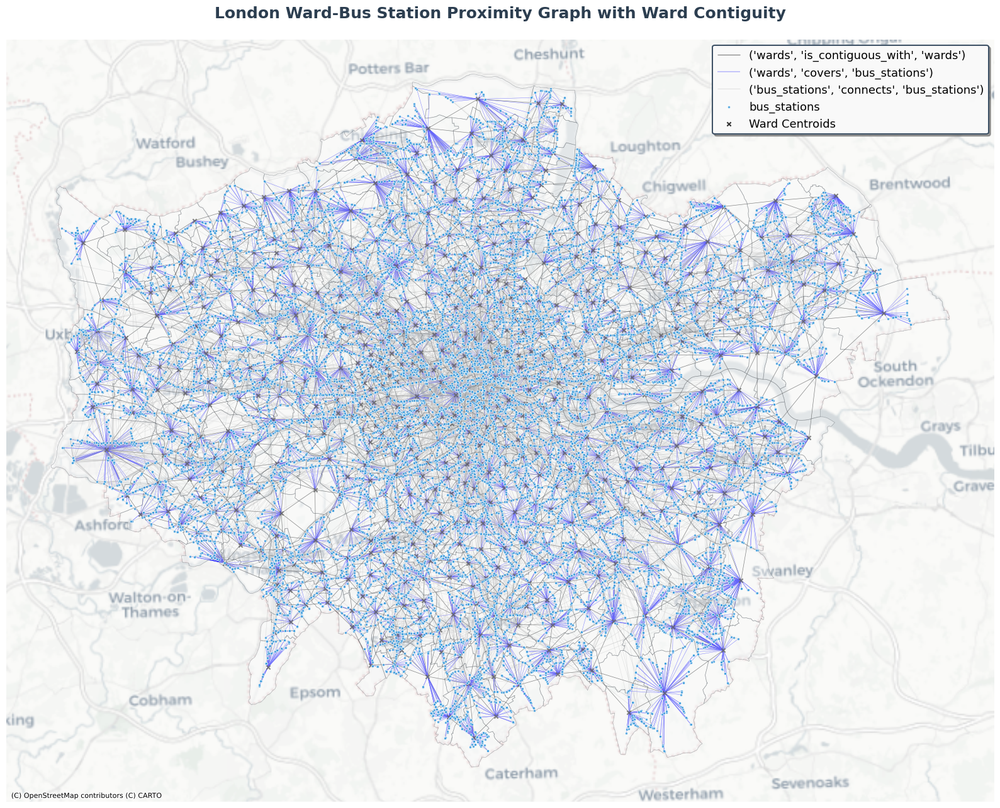

In [58]:
# Plot the combined heterogeneous graph with enhanced styling and beautiful colors
fig, ax = plt.subplots(1, 1, figsize=(16, 14))

# Use built-in plot_graph for heterogeneous graph plotting
c2g.plot_graph(
    nodes=combined_nodes,
    edges=combined_edges,
    ax=ax,
    node_color={
        'wards': '#F8F9FA',
        'bus_stations': '#3498DB'
    },
    node_edgecolor={
        'wards': '#495057',
        'bus_stations': 'white'
    },
    node_alpha={
        'wards': 0.4,
        'bus_stations': 0.8
    },
    markersize={'bus_stations': 8},
    edge_color={
        ('wards', 'is_contiguous_with', 'wards'): 'black',
        ('wards', 'covers', 'bus_stations'): 'blue',
        ('bus_stations', 'connects', 'bus_stations'): 'gray' # Add valid color if needed, or it will use default
    },
    edge_linewidth={
        ('wards', 'is_contiguous_with', 'wards'): 0.5,
        ('wards', 'covers', 'bus_stations'): 0.3
    },
    edge_alpha={
        ('wards', 'is_contiguous_with', 'wards'): 0.8,
        ('wards', 'covers', 'bus_stations'): 1
    },
    bgcolor="white",
    subplots=False
)

# Add centroids of polygons with black 'x' markers
centroids = combined_nodes['wards'].centroid
ax.scatter(centroids.x, centroids.y, color='black', s=20, alpha=0.8, marker='x', label='Ward Centroids')

# Add basemap with a clean, modern style
ctx.add_basemap(ax, crs=combined_nodes['wards'].crs, source=ctx.providers.CartoDB.Positron)

# Enhanced title and styling
ax.set_title('London Ward-Bus Station Proximity Graph with Ward Contiguity', 
             fontsize=18, fontweight='bold', pad=25, color='#2C3E50')

# Beautiful legend with custom styling
legend = ax.legend(
    loc='upper right', 
    fontsize=13, 
    framealpha=0.95,
    fancybox=True,
    shadow=True,
    edgecolor='#34495E',
    facecolor='white'
)
legend.get_frame().set_linewidth(1.5)

ax.set_aspect('equal')
ax.axis('off')

# Add subtle border around the plot
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.show()